<a href="https://colab.research.google.com/github/azhara001/Fabric-Composition-Extraction/blob/main/Fine_Tuning_DONUT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Fine Tuning attempt with Trainer Class

In [2]:
# # # installing dependencies and restart runtime afterwards

# !pip install transformers[sentencepiece]
# !pip install tqdm
# !pip install datasets
# !pip install accelerate -U
# !pip install -q pytorch-lightning wandb

In [3]:
# mounting GoogleDrive
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Capstone_Repo

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Capstone_Repo


In [1]:
# running huggingface-cli login
from huggingface_hub import notebook_login

# enter the following token:
notebook_login()

# import our dataset (uploaded to huggingface hub)

from datasets import load_dataset

In [ ]:
dataset = load_dataset("azhara001/Fabric-Composition-Tags-v2")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/469 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/119 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/66 [00:00<?, ? examples/s]

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 469
    })
    validation: Dataset({
        features: ['image', 'text'],
        num_rows: 119
    })
    test: Dataset({
        features: ['image', 'text'],
        num_rows: 66
    })
})

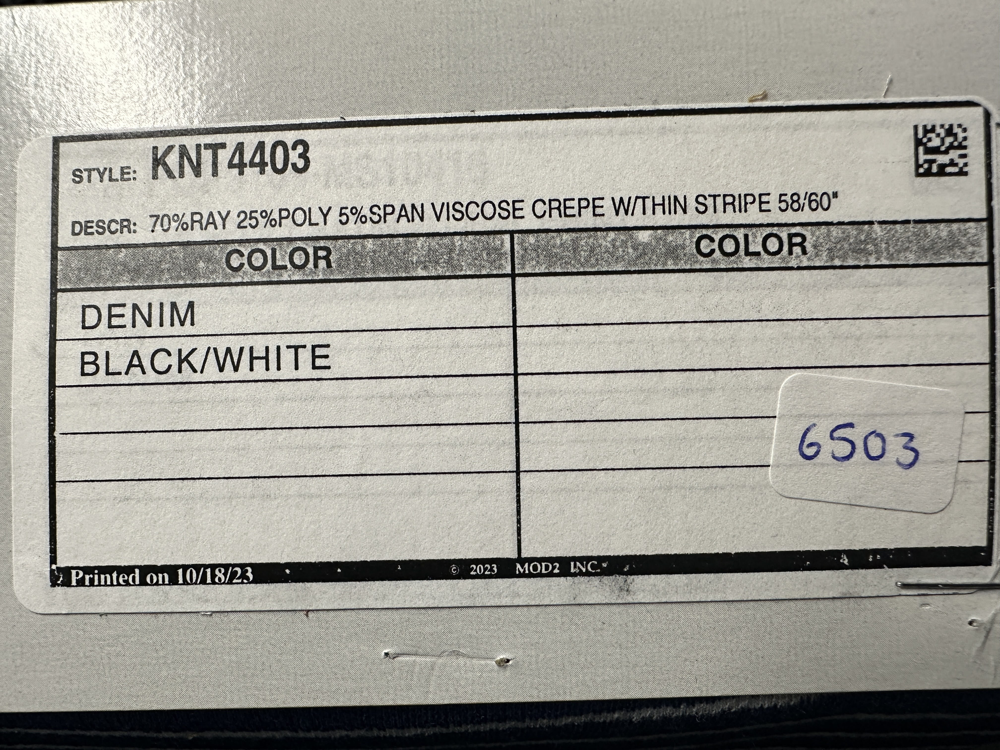

In [ ]:
# loading a sample for sanity check
dataset['train']['image'][0]

In [ ]:
dataset['train']['text'][0]

{'sample_id': 6503.0,
 'composition': {'polyester': 25.0,
  'elastane': 5.0,
  'rayon': 70.0,
  'cotton': None,
  'tencel': None,
  'nylon': None,
  'viscose': None,
  'modal': None,
  'nylon_6': None,
  'nylon_66': None,
  'cupro': None,
  'micromodal': None},
 'composition_raw_text': 'DESCR: 70%RAY 25%POLY  5%SPAN VISCOSE CREPE W/THIN STRIPE 58/60"',
 'composition_flag': 'DESCR:'}

In [ ]:
dataset_sample_train = dataset["train"].shuffle(seed=42).select(range(20)) # picking 5 samples for now
dataset_sample_validation = dataset["validation"].shuffle(seed=42).select(range(5)) # picking 5 samples for now

In [ ]:
# dataset_sample = dataset["train","validation"].shuffle(seed=42).select(range(20)) # picking 5 samples for now
# dataset_sample

In [ ]:
import json
# the keys in our labels: groundtruth
new_special_tokens = [] # new tokens which will be added to the tokenizer
task_start_token = "<s>"  # start of task token
eos_token = "</s>" # eos token of tokenizer

def json2token(obj, update_special_tokens_for_json_key: bool = True, sort_json_key: bool = True):
    """
    Convert an ordered JSON object into a token sequence
    """
    if type(obj) == dict:
        if len(obj) == 1 and "text_sequence" in obj:
            return obj["text_sequence"]
        else:
            output = ""
            if sort_json_key:
                keys = sorted(obj.keys(), reverse=True)
            else:
                keys = obj.keys()
            for k in keys:
                if update_special_tokens_for_json_key:
                    new_special_tokens.append(fr"<s_{k}>") if fr"<s_{k}>" not in new_special_tokens else None
                    new_special_tokens.append(fr"</s_{k}>") if fr"</s_{k}>" not in new_special_tokens else None
                output += (
                    fr"<s_{k}>"
                    + json2token(obj[k], update_special_tokens_for_json_key, sort_json_key)
                    + fr"</s_{k}>"
                )
            return output
    elif type(obj) == list:
        return r"<sep/>".join(
            [json2token(item, update_special_tokens_for_json_key, sort_json_key) for item in obj]
        )
    else:
        # excluded special tokens for now
        obj = str(obj)
        if f"<{obj}/>" in new_special_tokens:
            obj = f"<{obj}/>"  # for categorical special tokens
        return obj


def preprocess_documents_for_donut(sample):
    # create Donut-style input
    # text = json.loads(sample["text"])
    text = sample['text']
    text = {k:text[k] for k in text if k in ['sample_id','composition']}
    d_doc = task_start_token + json2token(text) + eos_token
    print(d_doc)
    # convert all images to RGB
    image = sample["image"].convert('RGB')
    return {"image": image, "text": d_doc}

proc_dataset_train = dataset_sample_train.map(preprocess_documents_for_donut)
proc_dataset_validation = dataset_sample_validation.map(preprocess_documents_for_donut)


Map:   0%|          | 0/20 [00:00<?, ? examples/s]

<s><s_sample_id>8134.0</s_sample_id><s_composition><s_viscose>None</s_viscose><s_tencel>None</s_tencel><s_rayon>None</s_rayon><s_polyester>None</s_polyester><s_nylon_66>None</s_nylon_66><s_nylon_6>None</s_nylon_6><s_nylon>None</s_nylon><s_modal>None</s_modal><s_micromodal>None</s_micromodal><s_elastane>None</s_elastane><s_cupro>None</s_cupro><s_cotton>100.0</s_cotton></s_composition></s>
<s><s_sample_id>7772.0</s_sample_id><s_composition><s_viscose>100.0</s_viscose><s_tencel>None</s_tencel><s_rayon>None</s_rayon><s_polyester>None</s_polyester><s_nylon_66>None</s_nylon_66><s_nylon_6>None</s_nylon_6><s_nylon>None</s_nylon><s_modal>None</s_modal><s_micromodal>None</s_micromodal><s_elastane>None</s_elastane><s_cupro>None</s_cupro><s_cotton>None</s_cotton></s_composition></s>
<s><s_sample_id>6569.0</s_sample_id><s_composition><s_viscose>None</s_viscose><s_tencel>None</s_tencel><s_rayon>None</s_rayon><s_polyester>None</s_polyester><s_nylon_66>None</s_nylon_66><s_nylon_6>None</s_nylon_6><s_ny

KeyboardInterrupt: 

In [ ]:
print(f"Sample: {proc_dataset_train[2]['text']}")
print(f"New special tokens: {new_special_tokens + [task_start_token] + [eos_token]}")
#    Sample: <s><s_total>$6.90</s_total><s_date>27 MAR 2018</s_date><s_company>UNIHAKKA INTERNATIONAL SDN BHD</s_company><s_address>12, JALAN TAMPOI 7/4,KAWASAN PARINDUSTRIAN TAMPOI,81200 JOHOR BAHRU,JOHOR</s_address></s>
#    New special tokens: ['<s_total>', '</s_total>', '<s_date>', '</s_date>', '<s_company>', '</s_company>', '<s_address>', '</s_address>', '<s>', '</s>']


Sample: <s><s_sample_id>6707.0</s_sample_id><s_composition><s_viscose>None</s_viscose><s_tencel>None</s_tencel><s_rayon>None</s_rayon><s_polyester>None</s_polyester><s_nylon_66>None</s_nylon_66><s_nylon_6>None</s_nylon_6><s_nylon>None</s_nylon><s_modal>47.0</s_modal><s_elastane>6.0</s_elastane><s_cotton>47.0</s_cotton></s_composition></s>
New special tokens: ['<s_sample_id>', '</s_sample_id>', '<s_composition>', '</s_composition>', '<s_viscose>', '</s_viscose>', '<s_tencel>', '</s_tencel>', '<s_rayon>', '</s_rayon>', '<s_polyester>', '</s_polyester>', '<s_nylon_66>', '</s_nylon_66>', '<s_nylon_6>', '</s_nylon_6>', '<s_nylon>', '</s_nylon>', '<s_modal>', '</s_modal>', '<s_elastane>', '</s_elastane>', '<s_cotton>', '</s_cotton>', '<s>', '</s>']


In [ ]:
from transformers import DonutProcessor

# Load processor
# processor = DonutProcessor.from_pretrained("naver-clova-ix/donut-base")
processor = DonutProcessor.from_pretrained("naver-clova-ix/donut-base-finetuned-cord-v2")

# add new special tokens to tokenizer
processor.tokenizer.add_special_tokens({"additional_special_tokens": new_special_tokens + [task_start_token] + [eos_token]})

# we update some settings which differ from pretraining; namely the size of the images + no rotation required
# resizing the image to smaller sizes from [1920, 2560] to [960,1280]
# processor.feature_extractor.size = [720,960] # should be (width, height)
processor.feature_extractor.do_align_long_axis = False


preprocessor_config.json:   0%|          | 0.00/362 [00:00<?, ?B/s]

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


tokenizer_config.json:   0%|          | 0.00/536 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/4.02M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/1.52k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/335 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/donut/processing_donut.py:190: FutureWarning: `feature_extractor` is deprecated and will be removed in v5. Use `image_processor` instead.
  warnings.warn(


In [ ]:
def transform_and_tokenize(sample, processor=processor, split="train", max_length=512, ignore_id=-100):
    # create tensor from image
    try:
        pixel_values = processor(
            sample["image"], random_padding=split == "train", return_tensors="pt"
        ).pixel_values.squeeze()
    except Exception as e:
        print(sample)
        print(f"Error: {e}")
        return {}

    # tokenize document
    input_ids = processor.tokenizer(
        sample["text"],
        add_special_tokens=False,
        max_length=max_length,
        padding="max_length",
        truncation=True,
        return_tensors="pt",
    )["input_ids"].squeeze(0)

    labels = input_ids.clone()
    labels[labels == processor.tokenizer.pad_token_id] = ignore_id  # model doesn't need to predict pad token
    return {"pixel_values": pixel_values, "labels": labels, "target_sequence": sample["text"]}

# need at least 32-64GB of RAM to run this
processed_dataset = proc_dataset.map(transform_and_tokenize,remove_columns=["image","text"])


Map:   0%|          | 0/5 [00:00<?, ? examples/s]

In [ ]:
# processed_dataset[0]['labels']

In [ ]:
import torch
from transformers import VisionEncoderDecoderModel, VisionEncoderDecoderConfig

# Load model from huggingface.co
# model = VisionEncoderDecoderModel.from_pretrained("naver-clova-ix/donut-base")
model = VisionEncoderDecoderModel.from_pretrained("naver-clova-ix/donut-base-finetuned-cord-v2")

# Resize embedding layer to match vocabulary size
new_emb = model.decoder.resize_token_embeddings(len(processor.tokenizer))
print(f"New embedding size: {new_emb}")
# Adjust our image size and output sequence lengths
# model.config.encoder.image_size = processor.feature_extractor.size[::-1] # (height, width)
model.config.decoder.max_length = len(max(processed_dataset["labels"], key=len))

# Add task token for decoder to start
model.config.pad_token_id = processor.tokenizer.pad_token_id
model.config.decoder_start_token_id = processor.tokenizer.convert_tokens_to_ids(['<s>'])[0]

# is done by Trainer
# device = "cuda" if torch.cuda.is_available() else "cpu"
# model.to(device)


config.json:   0%|          | 0.00/4.74k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/806M [00:00<?, ?B/s]

New embedding size: Embedding(57580, 1024, padding_idx=1)


In [ ]:
from huggingface_hub import HfFolder
from transformers import Seq2SeqTrainingArguments, Seq2SeqTrainer

# hyperparameters used for multiple args
hf_repository_id = "donut-base-demo"

# Arguments for training
training_args = Seq2SeqTrainingArguments(
    output_dir=hf_repository_id,
    num_train_epochs=20,
    learning_rate=2e-5,
    per_device_train_batch_size=2,
    weight_decay=0.01,
    fp16=True,
    logging_steps=100,
    save_total_limit=2,
    evaluation_strategy="no",
    save_strategy="epoch",
    predict_with_generate=True,
    # push to hub parameters
    report_to="tensorboard",
    push_to_hub=True,
    hub_strategy="every_save",
    hub_model_id=hf_repository_id,
    hub_token=HfFolder.get_token(),
)

# Create Trainer
trainer = Seq2SeqTrainer(
    model=model,
    args=training_args,
    train_dataset=processed_dataset,
)

/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:432: FutureWarning: Passing the following arguments to `Accelerator` is deprecated and will be removed in version 1.0 of Accelerate: dict_keys(['dispatch_batches', 'split_batches', 'even_batches', 'use_seedable_sampler']). Please pass an `accelerate.DataLoaderConfiguration` instead: 
dataloader_config = DataLoaderConfiguration(dispatch_batches=None, split_batches=False, even_batches=True, use_seedable_sampler=True)
  warnings.warn(


In [ ]:
trainer.train()

Step,Training Loss


Removed shared tensor {'decoder.lm_head.weight'} while saving. This should be OK, but check by verifying that you don't receive any warning while reloading


TrainOutput(global_step=60, training_loss=1.9736663818359375, metrics={'train_runtime': 399.288, 'train_samples_per_second': 0.25, 'train_steps_per_second': 0.15, 'total_flos': 3.1269116510208e+17, 'train_loss': 1.9736663818359375, 'epoch': 20.0})

In [ ]:
task_prompt = "<s>"
decoder_input_ids = processor.tokenizer(task_prompt, add_special_tokens=False, return_tensors="pt").input_ids
decoder_input_ids
pixel_values = torch.tensor(test_sample["pixel_values"])#.unsqueeze(0)
pixel_values.shape

torch.Size([1, 3, 2560, 1920])

In [ ]:
pixel_values.squeeze().shape

torch.Size([3, 2560, 1920])

In [ ]:
import re
import transformers
from PIL import Image
from transformers import DonutProcessor, VisionEncoderDecoderModel
import torch
import random
import numpy as np

# hidde logs
transformers.logging.disable_default_handler()


# # Load our model from Hugging Face
# processor = DonutProcessor.from_pretrained("azhara001/donut-base-demo")
# model = VisionEncoderDecoderModel.from_pretrained("azhara001/donut-base-demo")

# Move model to GPU
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

# Load random document image from the test set
# test_sample = processed_dataset["test"][random.randint(1, 50)]
test_sample = processed_dataset.shuffle(seed=42).select(range(1))

def run_prediction(sample, model=model, processor=processor):
    # prepare inputs
    pixel_values = torch.tensor(test_sample["pixel_values"])#.unsqueeze(0)
    task_prompt = "<s>"
    decoder_input_ids = processor.tokenizer(task_prompt, add_special_tokens=False, return_tensors="pt").input_ids

    # run inference
    outputs = model.generate(
        pixel_values.to(device),
        decoder_input_ids=decoder_input_ids.to(device),
        max_length=model.decoder.config.max_position_embeddings,
        early_stopping=True,
        pad_token_id=processor.tokenizer.pad_token_id,
        eos_token_id=processor.tokenizer.eos_token_id,
        use_cache=True,
        num_beams=1,
        bad_words_ids=[[processor.tokenizer.unk_token_id]],
        return_dict_in_generate=True,
    )

    # process output
    prediction = processor.batch_decode(outputs.sequences)[0]
    prediction = processor.token2json(prediction)

    # load reference target
    target = processor.token2json(test_sample["target_sequence"][0])
    return prediction, target

prediction, target = run_prediction(test_sample)
# print(f"Reference:\n {target}")
# print(f"Prediction:\n {prediction}")
# processor.feature_extractor.to_pil_image(np.array(test_sample["pixel_values"])).resize((350,600))


/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:453: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


In [ ]:
test_sample['target_sequence'][0]

'<s><s_sample_id>6745.0</s_sample_id><s_composition><s_viscose>None</s_viscose><s_tencel>None</s_tencel><s_rayon>None</s_rayon><s_polyester>37.0</s_polyester><s_nylon_66>None</s_nylon_66><s_nylon_6>None</s_nylon_6><s_nylon>None</s_nylon><s_modal>None</s_modal><s_elastane>None</s_elastane><s_cotton>63.0</s_cotton></s_composition></s>'

In [ ]:
print(f"Reference:\n {target}")
print(f"Prediction:\n {prediction}")

Reference:
 {'sample_id': '6745.0', 'composition': {'viscose': 'None', 'tencel': 'None', 'rayon': 'None', 'polyester': '37.0', 'nylon_66': 'None', 'nylon_6': 'None', 'nylon': 'None', 'modal': 'None', 'elastane': 'None', 'cotton': '63.0'}}
Prediction:
 {'text_sequence': '<s> <><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><><

In [ ]:
prediction

{'text_sequence': '<s><s><s>00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000.0.000.00.00.0000.000.0.00.0.0000.0.000.0000.0000.00.0.0.0000.0.0000.00.0000.00.00.0.0.00.0000.0.0.0.00.0.0.0.0.000.00.0.0.00000.0.0.0.0.0.0.0.00.0.0.000.0.0.0.0.000.0.00.0.0.000.0.0.0.00.0.0.0.0.00.0.0.0.0.0.0.0.0.0.00‰000.0.0/1.0.0.0.0.0.0.0.0.0.0.00.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.00.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.0.00.0.0.0.0.0.0.0.0.0.0.0.0。0000。0.0.0.0.0 0.000.00000.00000.0.000.00.0。0.0.000.00000。000.0000000.0。00000.000000000.00.000000.00.0000000.000000000000000

### Finetuning with custom Torch Loop

In [28]:
dataset['train'][0]['text']

NameError: name 'dataset' is not defined

In [2]:
from transformers import VisionEncoderDecoderConfig

image_size = [1280, 960] # starting with the custom image size
max_length = 768

config = VisionEncoderDecoderConfig.from_pretrained("naver-clova-ix/donut-base")
config.encoder.image_size = image_size
config.decoder.max_length = max_length

from transformers import DonutProcessor, VisionEncoderDecoderModel

processor = DonutProcessor.from_pretrained("naver-clova-ix/donut-base")
model = VisionEncoderDecoderModel.from_pretrained("naver-clova-ix/donut-base",config=config)


# Load model directly
from transformers import AutoTokenizer, AutoModel

# tokenizer = AutoTokenizer.from_pretrained("naver-clova-ix/donut-base-finetuned-cord-v2")
# model = AutoModel.from_pretrained("naver-clova-ix/donut-base-finetuned-cord-v2")

#https://github.com/clovaai/donut/blob/0acc65a85d140852b8d9928565f0f6b2d98dc088/donut/model.py#L602


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


In [3]:
# test_data = load_dataset("naver-clova-ix/cord-v2")
# print("gt_parse" in test_data['train'][2]['ground_truth'])
# print(test_data['train'][2]['ground_truth'])


In [4]:
processor.image_processor.size = image_size[::-1] # should be (width, height)
processor.image_processor.do_align_long_axis = False

In [5]:
processor.image_processor.size

[960, 1280]

In [9]:
import json
import random
from typing import Any, List, Tuple

import torch
from torch.utils.data import Dataset

added_tokens = []

class DonutDataset(Dataset):
    """
    PyTorch Dataset for Donut. This class takes a HuggingFace Dataset as input.

    Each row, consists of image path(png/jpg/jpeg) and gt data (json/jsonl/txt),
    and it will be converted into pixel_values (vectorized image) and labels (input_ids of the tokenized string).

    Args:
        dataset_name_or_path: name of dataset (available at huggingface.co/datasets) or the path containing image files and metadata.jsonl
        max_length: the max number of tokens for the target sequences
        split: whether to load "train", "validation" or "test" split
        ignore_id: ignore_index for torch.nn.CrossEntropyLoss
        task_start_token: the special token to be fed to the decoder to conduct the target task
        prompt_end_token: the special token at the end of the sequences
        sort_json_key: whether or not to sort the JSON keys
    """

    def __init__(
        self,
        dataset_name_or_path: str,
        max_length: int,
        split: str = "train",
        ignore_id: int = -100,
        task_start_token: str = "<s>",
        prompt_end_token: str = None,
        sort_json_key: bool = True,
    ):
        super().__init__()

        self.max_length = max_length
        self.split = split
        self.ignore_id = ignore_id
        self.task_start_token = task_start_token
        self.prompt_end_token = prompt_end_token if prompt_end_token else task_start_token
        self.sort_json_key = sort_json_key

        self.dataset = load_dataset(dataset_name_or_path, split=self.split)#.select(range(20))
        self.dataset_length = len(self.dataset)

        self.gt_token_sequences = []
        for sample in self.dataset:
            # ground_truth = json.loads(sample["ground_truth"])
            # if "gt_parses" in ground_truth:  # when multiple ground truths are available, e.g., docvqa
            #     assert isinstance(ground_truth["gt_parses"], list)
            #     gt_jsons = ground_truth["gt_parses"]
            # else:
            #     assert "gt_parse" in ground_truth and isinstance(ground_truth["gt_parse"], dict)
            #     gt_jsons = [ground_truth["gt_parse"]]

            text = sample['text']
            text = {k:text[k] for k in text if k in ['sample_id','composition']}
            gt_jsons = [text]

            self.gt_token_sequences.append(
                [
                    self.json2token(
                        gt_json,
                        update_special_tokens_for_json_key=self.split == "train",
                        sort_json_key=self.sort_json_key,
                    )
                    + processor.tokenizer.eos_token
                    for gt_json in gt_jsons  # load json from list of json
                ]
            )
        # print(self.gt_token_sequences)
        self.add_tokens([self.task_start_token, self.gt_token_sequences[0][0], self.prompt_end_token])
        self.prompt_end_token_id = processor.tokenizer.convert_tokens_to_ids(self.prompt_end_token)

    def json2token(self, obj: Any, update_special_tokens_for_json_key: bool = True, sort_json_key: bool = True):
        """
        Convert an ordered JSON object into a token sequence
        """
        if type(obj) == dict:
            if len(obj) == 1 and "text_sequence" in obj:
                return obj["text_sequence"]
            else:
                output = ""
                if sort_json_key:
                    keys = sorted(obj.keys(), reverse=True)
                else:
                    keys = obj.keys()
                for k in keys:
                    if update_special_tokens_for_json_key:
                        self.add_tokens([fr"<s_{k}>", fr"</s_{k}>"])
                    output += (
                        fr"<s_{k}>"
                        + self.json2token(obj[k], update_special_tokens_for_json_key, sort_json_key)
                        + fr"</s_{k}>"
                    )
                return output
        elif type(obj) == list:
            return r"<sep/>".join(
                [self.json2token(item, update_special_tokens_for_json_key, sort_json_key) for item in obj]
            )
        else:
            obj = str(obj)
            if f"<{obj}/>" in added_tokens:
                obj = f"<{obj}/>"  # for categorical special tokens
            return obj

    def add_tokens(self, list_of_tokens: List[str]):
        """
        Add special tokens to tokenizer and resize the token embeddings of the decoder
        """
        newly_added_num = processor.tokenizer.add_tokens(list_of_tokens)
        if newly_added_num > 0:
            model.decoder.resize_token_embeddings(len(processor.tokenizer))
            added_tokens.extend(list_of_tokens)

    def __len__(self) -> int:
        return self.dataset_length

    def __getitem__(self, idx: int) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        """
        Load image from image_path of given dataset_path and convert into input_tensor and labels
        Convert gt data into input_ids (tokenized string)
        Returns:
            input_tensor : preprocessed image
            input_ids : tokenized gt_data
            labels : masked labels (model doesn't need to predict prompt and pad token)
        """
        sample = self.dataset[idx]

        # inputs
        pixel_values = processor(sample["image"], random_padding=self.split == "train", return_tensors="pt").pixel_values
        pixel_values = pixel_values.squeeze()

        # targets
        target_sequence = random.choice(self.gt_token_sequences[idx])  # can be more than one, e.g., DocVQA Task 1
        input_ids = processor.tokenizer(
            target_sequence,
            add_special_tokens=False,
            max_length=self.max_length,
            padding="max_length",
            truncation=True,
            return_tensors="pt",
        )["input_ids"].squeeze(0)

        labels = input_ids.clone()
        labels[labels == processor.tokenizer.pad_token_id] = self.ignore_id  # model doesn't need to predict pad token
        # labels[: torch.nonzero(labels == self.prompt_end_token_id).sum() + 1] = self.ignore_id  # model doesn't need to predict prompt (for VQA)
        return pixel_values, labels, target_sequence

In [10]:
path = "naver-clova-ix/cord-v2"
path = "azhara001/Fabric-Composition-Tags-v2"

train_dataset = DonutDataset(path, max_length=max_length,
                             split="train", task_start_token="<s_demo_v1>", prompt_end_token="<s_demo_v1>",
                             sort_json_key=False, # cord dataset is preprocessed, so no need for this
                             )

val_dataset = DonutDataset(path, max_length=max_length,
                             split="validation", task_start_token="<s_demo_v1>", prompt_end_token="<s_demo_v1>",
                             sort_json_key=False, # cord dataset is preprocessed, so no need for this
                             )

In [11]:
len(added_tokens)

0

In [12]:
print(added_tokens)

[]


In [13]:
print("Original number of tokens:", processor.tokenizer.vocab_size)
print("Number of tokens after adding special tokens:", len(processor.tokenizer))

Original number of tokens: 57522
Number of tokens after adding special tokens: 57556


In [14]:
processor.decode([57555])

'<s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition></s>'

In [15]:
pixel_values, labels, target_sequence = train_dataset[0]

In [16]:
pixel_values, labels, target_sequence = train_dataset[0]

In [17]:
# let's print the labels (the first 30 token ID's)
for id in labels.tolist()[:30]:
  if id != -100:
    print(processor.decode([id]))
  else:
    print(id)

<s_sample_id>
65
03.
0
</s_sample_id>
<s_composition>
<s_polyester>
25.
0
</s_polyester>
<s_elastane>
5.
0
</s_elastane>
<s_rayon>
70
.
0
</s_rayon>
<s_cotton>
No
ne
</s_cotton>
<s_tencel>
No
ne
</s_tencel>
<s_nylon>
No
ne


In [18]:
print(target_sequence)
target_sequence


<s_sample_id>6503.0</s_sample_id><s_composition><s_polyester>25.0</s_polyester><s_elastane>5.0</s_elastane><s_rayon>70.0</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition></s>


'<s_sample_id>6503.0</s_sample_id><s_composition><s_polyester>25.0</s_polyester><s_elastane>5.0</s_elastane><s_rayon>70.0</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition></s>'

In [19]:
model.config.pad_token_id = processor.tokenizer.pad_token_id
model.config.decoder_start_token_id = processor.tokenizer.convert_tokens_to_ids(['<s_demo_v1>'])[0]

In [20]:
# sanity check
print("Pad token ID:", processor.decode([model.config.pad_token_id]))
print("Decoder start token ID:", processor.decode([model.config.decoder_start_token_id]))

Pad token ID: <pad>
Decoder start token ID: <s_demo_v1>


In [21]:
from torch.utils.data import DataLoader

# feel free to increase the batch size if you have a lot of memory
# I'm fine-tuning on Colab and given the large image size, batch size > 1 is not feasible
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=4)
val_dataloader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=4)

In [22]:
batch = next(iter(train_dataloader))
pixel_values, labels, target_sequences = batch
print(pixel_values.shape)

torch.Size([1, 3, 1280, 960])


In [23]:
for id in labels.squeeze().tolist()[:30]:
  if id != -100:
    print(processor.decode([id]))
  else:
    print(id)

<s_sample_id>
80
77
.
0
</s_sample_id>
<s_composition>
<s_polyester>
33.
0
</s_polyester>
<s_elastane>
1.0
</s_elastane>
<s_rayon>
No
ne
</s_rayon>
<s_cotton>
66
.
0
</s_cotton>
<s_tencel>
No
ne
</s_tencel>
<s_nylon>
No
ne


In [24]:
from pathlib import Path
import re
from nltk import edit_distance
import numpy as np
import math

from torch.nn.utils.rnn import pad_sequence
from torch.optim.lr_scheduler import LambdaLR

import pytorch_lightning as pl
from pytorch_lightning.utilities import rank_zero_only


class DonutModelPLModule(pl.LightningModule):
    def __init__(self, config, processor, model):
        super().__init__()
        self.config = config
        self.processor = processor
        self.model = model

    def training_step(self, batch, batch_idx):
        pixel_values, labels, _ = batch

        outputs = self.model(pixel_values, labels=labels)
        loss = outputs.loss
        self.log("train_loss", loss)
        return loss

    def validation_step(self, batch, batch_idx, dataset_idx=0):
        pixel_values, labels, answers = batch
        batch_size = pixel_values.shape[0]
        # we feed the prompt to the model
        decoder_input_ids = torch.full((batch_size, 1), self.model.config.decoder_start_token_id, device=self.device)

        outputs = self.model.generate(pixel_values,
                                   decoder_input_ids=decoder_input_ids,
                                   max_length=max_length,
                                   early_stopping=True,
                                   pad_token_id=self.processor.tokenizer.pad_token_id,
                                   eos_token_id=self.processor.tokenizer.eos_token_id,
                                   use_cache=True,
                                   num_beams=1,
                                   bad_words_ids=[[self.processor.tokenizer.unk_token_id]],
                                   return_dict_in_generate=True,)

        predictions = []
        for seq in self.processor.tokenizer.batch_decode(outputs.sequences):
            seq = seq.replace(self.processor.tokenizer.eos_token, "").replace(self.processor.tokenizer.pad_token, "")
            seq = re.sub(r"<.*?>", "", seq, count=1).strip()  # remove first task start token
            predictions.append(seq)

        scores = []
        for pred, answer in zip(predictions, answers):
            pred = re.sub(r"(?:(?<=>) | (?=</s_))", "", pred)
            # NOT NEEDED ANYMORE
            # answer = re.sub(r"<.*?>", "", answer, count=1)
            answer = answer.replace(self.processor.tokenizer.eos_token, "")
            scores.append(edit_distance(pred, answer) / max(len(pred), len(answer)))

            if self.config.get("verbose", False) and len(scores) == 1:
                print(f"Prediction: {pred}")
                print(f"    Answer: {answer}")
                print(f" Normed ED: {scores[0]}")

        self.log("val_edit_distance", np.mean(scores))

        return scores

    def configure_optimizers(self):
        # you could also add a learning rate scheduler if you want
        optimizer = torch.optim.Adam(self.parameters(), lr=self.config.get("lr"))

        return optimizer

    def train_dataloader(self):
        return train_dataloader

    def val_dataloader(self):
        return val_dataloader

In [25]:
config = {"max_epochs":100,
          "val_check_interval":0.2, # how many times we want to validate during an epoch
          "check_val_every_n_epoch":1,
          "gradient_clip_val":1.0,
          "num_training_samples_per_epoch": 800,
          "lr":3e-5,
          "train_batch_sizes": [8],
          "val_batch_sizes": [1],
          # "seed":2022,
          "num_nodes": 1,
          "warmup_steps": 300, # 800/8*30/10, 10%
          "result_path": "./result",
          "verbose": True,
          }

model_module = DonutModelPLModule(config, processor, model)

In [26]:
# !huggingface-cli login

In [ ]:
from pytorch_lightning.loggers import WandbLogger
from pytorch_lightning.callbacks import Callback, EarlyStopping

# wandb_logger = WandbLogger(project="Donut", name="demo-run-fabric-composition")

# class PushToHubCallback(Callback):
#     def on_train_epoch_end(self, trainer, pl_module):
#         print(f"Pushing model to the hub, epoch {trainer.current_epoch}")
#         pl_module.model.push_to_hub("azhara001/donut-base-demo-v2",
#                                     commit_message=f"Training in progress, epoch {trainer.current_epoch}")

#     def on_train_end(self, trainer, pl_module):
#         print(f"Pushing model to the hub after training")
#         pl_module.processor.push_to_hub("azhara001/donut-base-demo-v2",
#                                     commit_message=f"Training done")
#         pl_module.model.push_to_hub("azhara001/donut-base-demo-v2",
#                                     commit_message=f"Training done")

early_stop_callback = EarlyStopping(monitor="val_edit_distance", patience=3, verbose=False, mode="min")

trainer = pl.Trainer(
        accelerator="gpu",
        devices=1,
        max_epochs=config.get("max_epochs"),
        val_check_interval=config.get("val_check_interval"),
        check_val_every_n_epoch=config.get("check_val_every_n_epoch"),
        gradient_clip_val=config.get("gradient_clip_val"),
        precision=16, # we'll use mixed precision
        num_sanity_val_steps=0,
        # logger=wandb_logger,
        # callbacks=[PushToHubCallback(), early_stop_callback],
)

trainer.fit(model_module)

/usr/local/lib/python3.10/dist-packages/lightning_fabric/connector.py:563: `precision=16` is supported for historical reasons but its usage is discouraged. Please set your precision to 16-mixed instead!
INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                      | Params
----------------------------------------------------
0 | model | VisionEncoderDecoderModel | 201 M 
----------------------------------------------------
201 M     Trainable params
0         Non-trainable para

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:453: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_nylon_66><s_cupro>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.19070904645476772


/usr/local/lib/python3.10/dist-packages/pytorch_lightning/utilities/data.py:77: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 1. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_nylon_66><s_cupro>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.14746543778801843
Prediction: <s_sample_id>6518.0</s_sample_id><s_composition><s_polyester>100.0</s_polyester><s_elastane>None</s_elastane><s_ray

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>652.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.013054830287206266
Prediction: <s_sample_id>65128.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tence

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>65128.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tence

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>49.0</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>35.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>2.0</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel><

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>65006.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0026041666666666665
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_ten

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>49.0</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>49.0</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>64.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>64.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>33.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>65006.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0026041666666666665
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0 reduz None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_ten

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>65128.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>65006.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0026041666666666665
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_ten

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>65006.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0026041666666666665
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_ten

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>65006.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0026041666666666665
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_ten

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>None</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon>49.0</s_cotton><s_tencel>None</s_tencel><s_nylon>N

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>39.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>49.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>39.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>19.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>652.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel><

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>49.0</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

Validation: |          | 0/? [00:00<?, ?it/s]

Prediction: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
    Answer: <s_sample_id>6506.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>None</s_elastane><s_rayon>None</s_rayon><s_cotton>100.0</s_cotton><s_tencel>None</s_tencel><s_nylon>None</s_nylon><s_viscose>None</s_viscose><s_modal>None</s_modal><s_nylon_6>None</s_nylon_6><s_nylon_66>None</s_nylon_66><s_cupro>None</s_cupro><s_micromodal>None</s_micromodal></s_composition>
 Normed ED: 0.0
Prediction: <s_sample_id>6512.0</s_sample_id><s_composition><s_polyester>None</s_polyester><s_elastane>2.0</s_elastane><s_rayon>None</s_rayon><s_cotton>24.0</s_cotton><s_tencel>None</s_tencel>

In [ ]:
model